# Capstone Project - The Battle of the Neighborhoods

## Identify location to a group of Coffee Shop open new Shops

by Juliano Magalhães da Silva

### Load Libraries

In [ ]:
# Import libraries: 

# pandas, numpy, regex and json library:
import pandas as pd # library for data analsysis
import json # library to handle JSON files
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
import numpy as np 
import re
from random import sample

# math functions to work with distance:
from math import sin, cos, sqrt, atan2, radians

#!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
from geopy.distance import great_circle

# Get and interact with HTML:
from bs4 import BeautifulSoup
import requests # library to handle requests

# folium:
#!conda install -c conda-forge folium=0.5.0 --yes
!conda install -c conda-forge folium=0.9.1 --yes
import folium # plotting library
from folium import plugins
from folium.plugins import HeatMap

# 
import seaborn as sns
from scipy import stats

#!conda install -c conda-forge matplotlib=3.1.0 --yes
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter
import matplotlib.colors as colors


# Backup and Restore Dataframes:
import types
from botocore.client import Config
import ibm_boto3
from IPython.display import HTML
import base64  

# Machine Learning - DBSCAN 
from sklearn.cluster import DBSCAN
import sklearn.utils
from sklearn.preprocessing import StandardScaler

def __iter__(self): return 0

print ("Library loaded!")

Solving environment: \ 

In [ ]:
# The code was removed by Watson Studio for sharing.

In [ ]:
# The code was removed by Watson Studio for sharing.

In [ ]:
# Function create a donwloadble link to backup DataFrames:
def create_download_link( df, title = "Download CSV file", filename = "df.csv"):  
    csv = df.to_csv()
    b64 = base64.b64encode(csv.encode())
    payload = b64.decode()
    html = '<a download="{filename}" href="data:text/csv;base64,{payload}" target="_blank">{title}</a>'
    html = html.format(payload=payload,title=title,filename=filename)
    return HTML(html)

<!-- A description of the data and how it will be used to solve the problem. (15 marks) -->
## Data:

With the objective:

* Determin a list of neighborhood to open new store
* Provide copetition location, and neighborhood characteristic where they are.

Starting with: 

* Determining the neighborhoods from each City and Geolocation.
* Number of Coffee Shop per Neighborhood.
* Create a characteristic to each neighborhood. 
* Explore the competition numbers and characteristics. 

## Data Acquisition

### Identiy Cities Neighborhoods

Neighborhood Information from: https://www.estadoecapitaisdobrasil.com

    There are a list of Neighborhood from each city:

      Rio de Janeiro: https://www.estadosecapitaisdobrasil.com/listas/lista-dos-bairros-do-rio-de-janeiro/
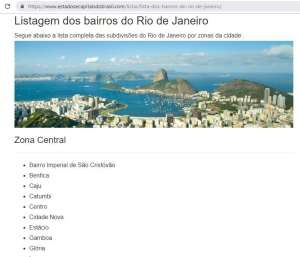

      São Paulo:      https://www.estadosecapitaisdobrasil.com/listas/lista-dos-bairros-de-sao-paulo/
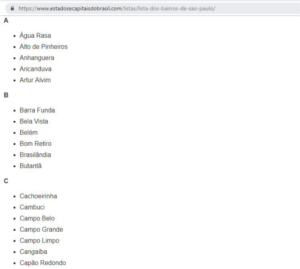

### Get Neighborhoods Name and Geolocation

#### Rio de Janeiro

In [7]:
# Get Rio de Janeiro Neighborhood Names:

url= 'https://www.estadosecapitaisdobrasil.com/listas/lista-dos-bairros-do-rio-de-janeiro/'
webpage = requests.get(url).text
#print (webpage)

l_begin = webpage.find('<h3>')
l_end = webpage.find('</li></ul> ')
#print (l_begin, ' -- ', l_end)

webpage = webpage[l_begin:l_end]

soup = BeautifulSoup(webpage, 'lxml')

neigh = soup.find_all('li')
# print (neigh[1])

neigh2 = []
for i in range(len(neigh)):
    neigh2.append(neigh[i].get_text().strip())
del(neigh)
# print ('Number of Neighborhoods from ',len(neigh2))
# Get Rio de Janeiro's Neighborhoods Geolocation: 
address = 'Rio de Janeiro, RJ'
geolocator = Nominatim(user_agent="rj_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
#print('The geograpical coordinate of Rio de Janeiro City are {}, {}.'.format(latitude, longitude))

neigh_map_rj = [address, latitude, longitude]
#print (neigh_map_rj)

neigh_map = []
for neigh in neigh2:
    try: 
        address = neigh + ',Rio de Janeiro, RJ'
        location = geolocator.geocode(address)
        latitude = location.latitude
        longitude = location.longitude
        #print('The geograpical coordinate of {} are {}, {}.'.format(address, latitude, longitude))
        neigh_map.append(['Rio de Janeiro', neigh, latitude, longitude])
    except:
        print ('error: ', neigh)
del (neigh2)
#print (neigh_map)

# Create DataFrame:
neighborhoods = pd.DataFrame(neigh_map, columns=['city','neighborhood','latitude','longitude'])
#print(neighborhoods.shape)
neighborhoods.head(10)

print (neighborhoods.shape)
neighborhoods.head(5)

(161, 4)
(161, 4)


,city,neighborhood,latitude,longitude
0,Rio de Janeiro,Bairro Imperial de São Cristóvão,-22.899318,-43.221935
1,Rio de Janeiro,Benfica,-22.892297,-43.240341
2,Rio de Janeiro,Caju,-22.880306,-43.221494
3,Rio de Janeiro,Catumbi,-22.919662,-43.199064
4,Rio de Janeiro,Centro,-22.904393,-43.183065


#### São Paulo

In [8]:
# Get São Paulo Neighborhood name:
url= 'https://www.estadosecapitaisdobrasil.com/listas/lista-dos-bairros-de-sao-paulo/'
webpage = requests.get(url).text
#print (webpage)

l_begin = webpage.find('<ul><li>')
l_end = webpage.find('</li></ul> ')
#print (l_begin, ' -- ', l_end)

webpage = webpage[l_begin:l_end]
#print (webpage)
soup = BeautifulSoup(webpage, 'lxml')

neigh = soup.find_all('li')
#print (neigh[1])

neigh2 = []
for i in range(len(neigh)):
    neigh2.append(neigh[i].get_text().strip().rstrip('\u200e'))
del(neigh)
# print ('Number of Neighborhoods from São Paulo: ',len(neigh2))

# Geolocation: 
address = 'Região Metropolitana de São Paulo'
geolocator = Nominatim(user_agent="sp_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
# print('The geograpical coordinate of {} are {}, {}.'.format(address, latitude, longitude))

neigh_map_sp = [address, latitude, longitude]
#print (neigh_map_sp)

neigh_map2 = []
for neigh in neigh2:
    try: 
        address = neigh + ',Região Metropolitana de São Paulo'
        location = geolocator.geocode(address)
        latitude = location.latitude
        longitude = location.longitude
        #print('The geograpical coordinate of {} are {}, {}.'.format(address, latitude, longitude))
        neigh_map2.append(['São Paulo', neigh, latitude, longitude])
    except:
        print ('error: ', neigh)
#del (neigh2)

# Create DataFrame:
neighborhoods2 = pd.DataFrame(neigh_map2, columns=['city','neighborhood','latitude','longitude'])
print(neighborhoods2.shape)
neighborhoods2.tail(5)

(90, 4)


,city,neighborhood,latitude,longitude
85,São Paulo,Vila Mariana,-23.589190,-46.634653
86,São Paulo,Vila Matilde,-23.536179,-46.524605
87,São Paulo,Vila Medeiros,-23.487707,-46.584496
88,São Paulo,Vila Prudente,-23.584416,-46.581956
89,São Paulo,Vila Sônia,-23.599935,-46.739162


In [9]:
# Unify dataframes:
dfneigh = neighborhoods.append(neighborhoods2) 
dfneigh.reset_index(drop=True)
try:
    del(neighorhoods, neighborhoods2)
except:
    False

print (dfneigh.shape)
dfneigh['city'].value_counts()

(251, 4)


Rio de Janeiro    161
São Paulo          90
Name: city, dtype: int64

#### Backup and Restore - Neighborhood:

In [11]:
create_download_link(dfneigh)

##### Restore Neighborhood to dfneigh DataFrame

In [ ]:
# The code was removed by Watson Studio for sharing.

In [ ]:
dfneigh = pd.read_csv(body)
print(dfneigh.shape)
dfneigh.head()

###  Create Map with Neighborhoods points:

Check if the Neighborhood are distribuited around the cities:

In [12]:
# Use L = 0 - Rio de Janeiro, 1 - São Paulo and 2 - Show both cities:
L = 2
location = [['Rio de Janeiro',-22.9110137,-43.2093727, 11],['São Paulo',-23.6236475,-46.3776385915519,11], ['RJ_SP', -23.234970, -44.708555,8]]
[name, loc_lat, loc_lng,zoom] = location[L]


venues_map = folium.Map(location=[loc_lat, loc_lng], zoom_start=zoom)
for lat, lng, label in zip(dfneigh.latitude, dfneigh.longitude, dfneigh.neighborhood):
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        fill=True,
        color='blue',
        fill_color='blue',
        fill_opacity=0.6
    ).add_to(venues_map)
venues_map

### Get Categories per City in FourSquare:

Search Foursquare for City's Categories. 
With the category, is possible to get more specific queries in each location and to identify venues that are focus of this work. The result will identify competition groups and places that they are.

In [237]:
# The geograpical coordinate of Rio de Janeiro City are -22.9110137, -43.2093727.
# ['Rio de Janeiro, RJ', -22.9110137, -43.2093727]
# The geograpical coordinate of Região Metropolitana de São Paulo are -23.6236475, -46.3776385915519.
# ['São Paulo, SP', -23.6236475, -46.3776385915519]

# Search Foursquare for Categories from Rio de Janeiro and São Paulo

location = [['RJ',-22.9110137,-43.2093727],['SP',-23.6236475,-46.3776385915519]]
radius = 100000 # Radius of 100,000 km
cat_list=[]
for [name, lat, lng] in location:
    url = 'https://api.foursquare.com/v2/venues/categories?&client_id={}&client_secret={}&v={}&ll={},{},&radius={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION,
            lat, 
            lng,
            radius)
    results = requests.get(url).json()["response"]
    i = 0
    # filter result to a list:
    for v in results['categories']:
        for k in results['categories'][i]['categories']:
            #print ( v['shortName'], '--->', k['shortName'], '-', k['id'] )
            cat_list.append( [v['name'], k['name'], k['id']] )
        i = i + 1

#print (results['categories'][0]['categories'][1]['shortName'])
        
df_cat = pd.DataFrame(cat_list, columns=['categories','subcat', 'id']) 
#del (cat_list)

# Deduplicate categories
#print (df_cat.shape)
df_cat.drop_duplicates(subset='id', keep='first', inplace=True)
#print (df_cat.shape)
#print (df_cat.head(10))

# Filter Category:
    # Coffee, also in portuguese: "Café" or variations.
    # Snack
    # Chocolate
    # Bakery
    # Tea
df_cat['filter'] = df_cat['subcat'].str.extract(r".*(Caf[eé]|Coffee|Snack|Chocolate|Bakery|Tea|Breakfast|Fast\sFood|Sandwich).*", expand=False)
df_cat_filter = df_cat[df_cat['filter'].notnull()]
print (df_cat_filter.shape)
print (df_cat_filter.head(30))
# join categories id to search in foursquare:
cat_id = df_cat_filter['id'].str.cat(sep=',')

(15, 4)
               categories                subcat                        id  \
38   College & University     College Cafeteria  4bf58dd8d48988d1a1941735   
77                   Food                Bakery  4bf58dd8d48988d16a941735   
80                   Food        Breakfast Spot  4bf58dd8d48988d143941735   
81                   Food       Bubble Tea Shop  52e81612bcbc57f1066b7a0c   
84                   Food             Cafeteria  4bf58dd8d48988d128941735   
85                   Food                  Café  4bf58dd8d48988d16d941735   
89                   Food           Coffee Shop  4bf58dd8d48988d1e0931735   
102                  Food  Fast Food Restaurant  4bf58dd8d48988d16e941735   
131                  Food              Pet Café  56aa371be4b08b9a8d573508   
138                  Food        Sandwich Place  4bf58dd8d48988d1c5941735   
143                  Food           Snack Place  4bf58dd8d48988d1c7941735   
150                  Food              Tea Room  4bf58dd8d48988d1dc9

In [165]:
# debug
#print (cat_id)
#print (df_cat[df_cat.subcat.str.contains('Snack')])
#print (df_cat.subcat.values)

### Query Foursquare - Venues:

Query Foursquare for Venues, using Categories selected to archive a more specific information.


In [231]:
# Function to get Venues filtering with Categories
# Explore Neighborhoods
def getNearbyVenues(category, latitudes, longitudes, cities, neigh, radius=10000):
    venues_list=[]
    for lat, lng, neigh, cities in zip(latitudes, longitudes, neigh, cities):
        name = neigh + ', ' + cities
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&categoryId={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            category,
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        #results = requests.get(url).json()["response"]["groups"][0]["items"]
        try:
            results = requests.get(url).json()["response"]["groups"][0]["items"]
            venues_list.append([(
                    name, 
                    neigh, 
                    lat, 
                    lng, 
                    v['venue']['id'], 
                    v['venue']['name'], 
                    v['venue']['location']['lat'], 
                    v['venue']['location']['lng'], 
                    (v['venue']['location']['city'] if ( 'city' in v['venue']['location']) else cities),
                    v['venue']['categories'][0]['name']) for v in results])
            nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
            nearby_venues.columns = ['location', 'neighborhood','n_lat', 'n_lng', 'v_id', 'venue', 'v_lat', 'v_lng', 'city', 'v_cat']
        except:
            False
    return(nearby_venues)

There are a limit of 3 categories per query in Foursquare.

Then the query need to be exceuted with 2 loops, to get all neighborhood and categories.

The query are set with a wide radius, to get all venues of interest.

In [ ]:
j = []
#temp = dfneigh
#dfneigh = temp[0:2]
venues = pd.DataFrame( columns = ['location', 'neighborhood','city','n_lat', 'n_lng', 'v_id', 'venue', 'v_lat', 'v_lng', 'v_cat'])

for i in range(0, df_cat_filter['id'].count(), 3):
    categories = ','.join(df_cat_filter['id'].iloc[i:i+3].values) 
    #print (categories)
    venues2 =  getNearbyVenues( categories,
                                latitudes  = dfneigh['latitude'],
                                longitudes = dfneigh['longitude'],
                                cities     = dfneigh['city'],
                                neigh      = dfneigh['neighborhood'] 
                               )
    if type(venues2) == type(dfneigh):
        venues = venues.append(venues2, ignore_index=True)
    #print (venues.shape)   

del (venues2)
print ("####################\n - Query end! -\n####################")

In [239]:
print (venues.shape)

(105088, 10)


In [240]:
venues.head()

,city,location,n_lat,n_lng,neighborhood,v_cat,v_id,v_lat,v_lng,venue
0,Rio de Janeiro,"Bairro Imperial de São Cristóvão, Rio de Janeiro",-22.899318,-43.221935,Bairro Imperial de São Cristóvão,Bakery,5893cd79a1492637fea30187,-22.902414,-43.217907,Il Pane e Gelato Sardo
1,Rio de Janeiro,"Bairro Imperial de São Cristóvão, Rio de Janeiro",-22.899318,-43.221935,Bairro Imperial de São Cristóvão,Bakery,4d1491a025cda1435b2c62d6,-22.922787,-43.222397,Rita de Cássia Gastronomia
2,Rio de Janeiro,"Bairro Imperial de São Cristóvão, Rio de Janeiro",-22.899318,-43.221935,Bairro Imperial de São Cristóvão,Bakery,4d40e33c255d8cfa61b56a05,-22.919416,-43.239011,Arte & Pão
3,Rio de Janeiro,"Bairro Imperial de São Cristóvão, Rio de Janeiro",-22.899318,-43.221935,Bairro Imperial de São Cristóvão,Bakery,4bcb5ec4937ca593bd6ea992,-22.920034,-43.258562,Confeitaria Vilamore
4,Rio de Janeiro,"Bairro Imperial de São Cristóvão, Rio de Janeiro",-22.899318,-43.221935,Bairro Imperial de São Cristóvão,Bakery,4d6513fc6ccdba7aa68a9ec3,-22.918876,-43.223968,Tijuca Mix Emporium Gourmet


## Backup and restore Data

In [241]:
# Backup dataframe venues:
create_download_link(venues)

In [121]:
create_download_link(df_cat)

In [ ]:
# The code was removed by Watson Studio for sharing.

In [ ]:
# Restore point:
venues = pd.read_csv(body)
venues.drop(['Unnamed: 0'], axis=1, inplace=True)
venues.head()

In [ ]:
#venues.columns = ['location', 'neighborhood','city','n_lat', 'n_lng', 'venue', 'v_lat', 'v_lng', 'v_cat']
print(venues.shape)

#Debug:
#venues[venues.venue == 'Starbucks'].head(10).sort_values('v_id', ascending=True)

## Check data

Analyze the data and search for errors, like duplicated values, information bad categorized, minor errors in venues name.

In [ ]:
venues.groupby('venue').count()[['city']].sort_values('city', ascending=False).head(10)

### Analyse Venues Categories:

In [ ]:
# Function that report Categories data:
def cat_report():
    print ('Categories Analyses')
    rep_col = ['Categorie', 'Total venues', 'Uniqe Venues']
    rep_venues = pd.DataFrame(columns=rep_col)
    for k in venues['v_cat'].value_counts().items(): 
        unique_vl = venues[venues.v_cat.isin([k[0]])]['venue'].value_counts().count()
        rep_venues = rep_venues.append(pd.Series([k[0], k[1], unique_vl], index=rep_col), ignore_index=True)
    return (rep_venues)

In [ ]:
#cat_report()

## Clean up and Normalize
### Deduplicate Venues

The result have very high values for 2 cities. 

Analising the data, per example Starbucks have to much Coffee Shops. 
Foursquare returned duplicated values, the same venue are present in more than one neighborhood. 

To determin which are the correct neighborhood for each venue, the distance between the venue to the neighborhood will corelated this information and that one with less distance will stay at the database.

The neighborhood are wide size then they will work only as a reference at this moment. 

In [ ]:
# Create a column with the distance from Venue to Neighborhood:
from math import sin, cos, sqrt, atan2, radians

# Function that calculate distance between 2 points:
def calc_dist(nlat, nlng, vlat, vlng):
    # approximate radius of earth in km
    R = 6373.0
    
    lat1 = radians(nlat)
    lon1 = radians(nlng)
    lat2 = radians(vlat)
    lon2 = radians(vlng)
    
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    
    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    
    distance = R * c
    
    return(distance)

print ('Function loaded!')

In [ ]:
# Create column "dist" with the value:
venues['dist'] = venues.apply(lambda x: calc_dist(x.n_lat, x.n_lng, x.v_lat, x.v_lng), axis=1)

# Sort table by Distance:
venues.sort_values('dist', ascending=True, inplace=True)

# Drop duplicated values:
venues.drop_duplicates(subset='v_id', keep='first', inplace=True)
print ('Duplicated values removed!')
venues.drop('dist', axis=1, inplace=True)

In [ ]:
# Check result:
print(venues.shape)
venues.sort_values(['city','neighborhood'], ascending=False, inplace=True)

venues.head(10)
#venues[venues.neighborhood.isin(['Anhanguera'])].head(10)

### Normalize City - Remove Cities diferente from Rio de Janeiro or São Paulo

In [ ]:
print(venues['city'].value_counts())
cities = ['Rio de Janeiro','São Paulo']
#print(venues.shape)
venues.drop(venues[~venues['city'].isin(cities)].index, axis=0, inplace=True)
#print(venues.shape)

### Normalize Venue Name:


In [ ]:
venues.loc[venues["venue"] == "Rei Do Mate", "venue"] = "Rei do Mate"
venues.loc[venues["venue"] == "EVS - Espaço Vida Saudável", "venue"] = "EVS - Espaço Vida Saudável Herbalife"
#venues[venues.venue == 'EVS - Espaço Vida Saudável Herbalife'].sort_values('v_id', ascending=True).shape

### Normalize Categorie per Venue:

In [ ]:
venues.loc[venues["venue"] == "MegaMatte", "v_cat"] = "Tea Room"
venues.loc[venues["venue"] == "Casa do Pão de Queijo", "v_cat"] = "Coffee Shop" 
#venues.loc[venues["venue"] == "Rei Do Mate", "v_cat"] = "Tea Room"
venues.loc[venues.venue.isin(['Rei do Mate']), "v_cat"] = "Tea Room"
venues.loc[venues["venue"] == "Kopenhagen", "v_cat"]  = "Chocolate Shop"
#venues[venues.venue.isin(['Rei do Mate'])]

### Normalize Categorie:

In [ ]:
# Normalize Café, Internet Cafe and College Cafeteria to Coffee Shop:
venues.loc[venues["v_cat"] == "Café", "v_cat"] = "Coffee Shop"
venues.loc[venues["v_cat"] == "Internet Cafe", "v_cat"] = "Coffee Shop"
venues.loc[venues["v_cat"] == "College Cafeteria", "v_cat"] = "Coffee Shop"
venues.loc[venues["v_cat"] == "Cafeteria", "v_cat"] = "Coffee Shop"

### Remove Categories with few venues:

In [ ]:
# Number of Venues by Categories:
tp_df = venues.groupby(['v_cat']).count()[['neighborhood']].sort_values('neighborhood', ascending=False)
tp_df.columns = ['cat_total']
try:
    venues.drop(['cat_total'], axis=1, inplace=True) 
except:
    False

venues = venues.join(tp_df, on='v_cat')
venues = venues.drop(venues[venues.cat_total < 30].index)

print(venues.shape)
cat_report()

## Data Understanding

###  Identify Group of Venues:
Create a column with the Total numbers of Venues with the same name.
This information will compose a Venue Score. 

In [ ]:
# Insert a column with Total Venue by Group:
tp_df = venues.groupby(['venue']).count()[['neighborhood']].sort_values('neighborhood', ascending=False)
tp_df.columns = ['v_total']
venues = venues.join(tp_df, on='venue')

In [ ]:
venues['v_total'] = ((venues['v_total'] / venues['v_total'].max()) * 100)

In [ ]:
print ('Result: ', venues.shape)
#venues.head(20)

## Top 20 Venues - Identify Competition - Coffee Shop Groups:

Analyse the data the same venue appeer more then once per neighborhood.

In [ ]:
# Venues:
v_total = venues.groupby('venue').count()[['city']].sort_values('city', ascending=False)

print ('Total of Venues: ', v_total.sum()[0])
print ('Number of Unique Venues: ', v_total.count()[0])

print ('---------------------')

# Neighborhood:
v_total = venues.groupby('location').count()[['city']].sort_values('city', ascending=False)

print ('Total of Neighborhood: ', dfneigh['neighborhood'].count())
print ('Number of Neighborhood with Venues in Categories filtered: ', v_total.count()[0])

v_total = venues.groupby(['location']).count()[['city']].sort_values('city', ascending=False)
print ('Number of Location with more Venues:')

v_total.reset_index(inplace=True)
v_total['Top'] = range(1, len(v_total) + 1)
v_total.set_index(['Top'], inplace=True)


print (v_total.head(25))

# Location x Venue:
#v_total = venues.groupby(['location','venue']).count()[['city']].sort_values('city', ascending=False)
#print ('\n\nNumber of Location with more Venues:')
#print (v_total.head(25))

#venues.groupby('venue').count()[['city']].sort_values('city', ascending=False)

In [ ]:
# Top Venue / Categorie:
v_total = venues.groupby(['venue','v_cat']).count()[['city']].sort_values('city', ascending=False)

print ('\n\nVenue Groups by Category:')
v_total.index.names = ['Venue_Groups', 'Category']
v_total.rename(columns={'city':'Qnt'}, inplace=True)
v_total.reset_index(inplace=True)
v_total['Top'] = range(1, len(v_total) + 1)
v_total.set_index(['Top'], inplace=True)
print (v_total.head(20))

                                    venue  Total
Top                                             
1                              Cacau Show    260
2                                  Subway    179
3                              Kopenhagen    117
4                             Rei do Mate    110
5                               Starbucks     81
6                               MegaMatte     71
7                 Chocolates Brasil Cacau     63
8                   Casa do Pão de Queijo     59
9    EVS - Espaço Vida Saudável Herbalife     48
10                          Grão Espresso     31
11                      California Coffee     21
12                            Fran's Café     21
13                                  Lindt     20
14                          Casa Bauducco     18
15                         Porto do Sabor     15
16                                 McCafé     15
17                             Brownieria     12
18                              Nespresso     11
19                  

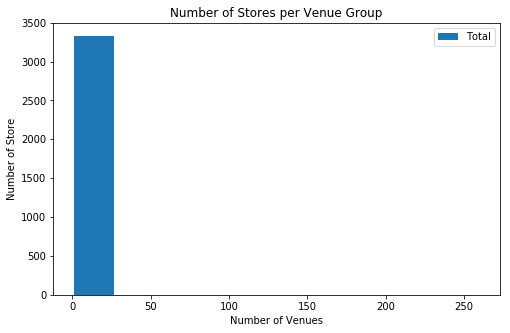

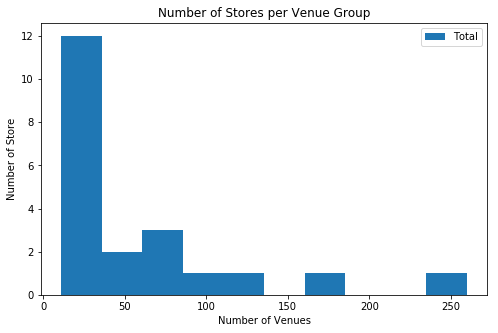

In [101]:
# Top Group of Venues:
v_top = venues.groupby('venue').count()[['city']].sort_values('city', ascending=False)
v_top.columns = ['Total']

v_top.reset_index(inplace=True)
v_top['Top'] = range(1, len(v_top) + 1)
v_top.set_index(['Top'], inplace=True)

# Top N:
print (v_top.head(20))

# Histogram:
def plot_hist(v_top):
    v_top.plot(kind='hist', figsize=(8, 5))

    plt.title('Number of Stores per Venue Group') 
    plt.ylabel('Number of Store') 
    plt.xlabel('Number of Venues') # add x-label
    plt.show()

# Distribution from Venues per Group:
plot_hist(v_top)

# Drop Venues with less than 10 Shop:
v_top = v_top.drop(v_top[v_top.Total <= 10].index)

# New Distribution from Venues per Group:
plot_hist(v_top)

In [102]:
N = 25

# total venues, number of groups, and 

df = venues.groupby('venue').count()[['city']].sort_values('city', ascending=False)
df.columns = ['Total']

df_bar = df['Total'].head(N)

df["cumpercentage"] = df["Total"].cumsum()/df["Total"].sum()*100

print ('Number Venues Names: ', venues.groupby('venue').count()[['city']].sort_values('city', ascending=False).tail(N * -1).count())
print ('Total Number of Venues: ', venues.groupby('venue').count()[['city']].sort_values('city', ascending=False).tail(-10).sum())

Number Venues Names:  city    3314
dtype: int64
Total Number of Venues:  city    3919
dtype: int64


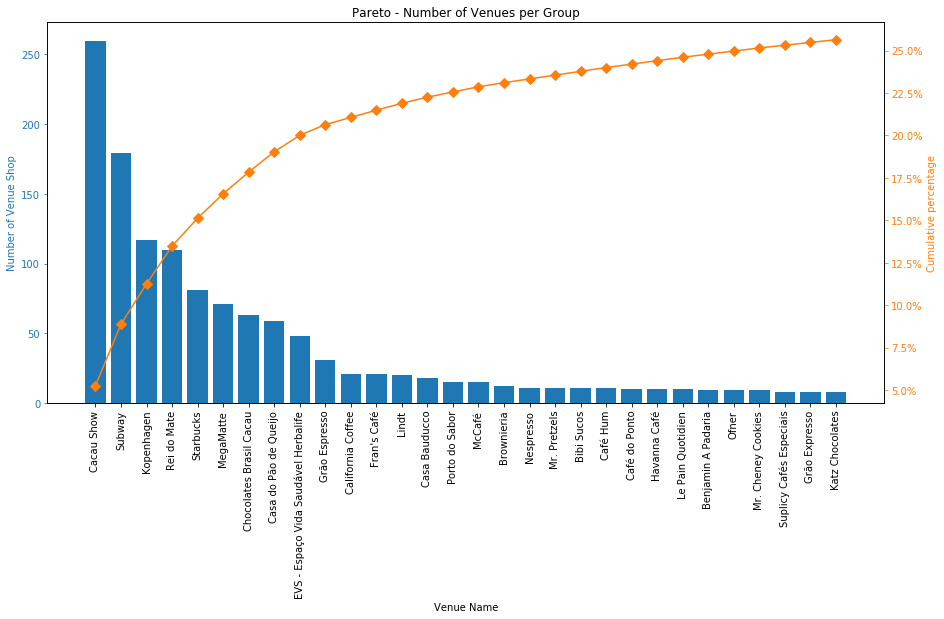

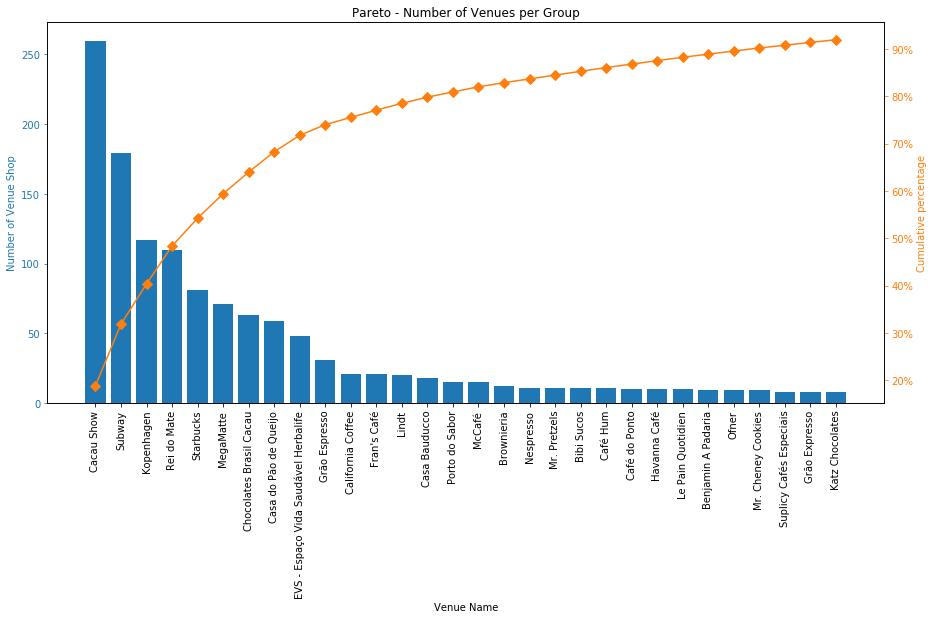

In [103]:
# Pareto
def plot_pareto(N, df):
    df["cumpercentage"] = df["Total"].cumsum()/df["Total"].sum()*100
    df = df[0:N]
    
    index = range(len(df))

    fig, ax = plt.subplots(figsize=(15,7))

    ax.bar(index, df["Total"], color="C0")
    plt.xticks(index, df.index)  # set the X ticks and labels
    plt.xticks(rotation='vertical')

    ax2 = ax.twinx()
    ax2.plot(index, df["cumpercentage"], color="C1", marker="D",ms=7)
    ax2.yaxis.set_major_formatter(PercentFormatter())

    ax.tick_params(axis="y", colors="C0")
    ax2.tick_params(axis="y", colors="C1")

    plt.title('Pareto - Number of Venues per Group',  loc='center')
    ax.set_xlabel('Venue Name')
    ax2.set_ylabel('Cumulative percentage', color='C1')
    ax.set_ylabel('Number of Venue Shop', color='C0')

    return(plt.show())

# All database:
v_top = venues.groupby('venue').count()[['city']].sort_values('city', ascending=False)
v_top.columns = ['Total']
plot_pareto(30, v_top)

print ('\n\n\n')

# Only with Groups with more than 5 venues:
v_top = v_top.drop(v_top[v_top.Total <= 5].index)
plot_pareto(30, v_top)


In [104]:
N = 15
print ('Top ',N,' Venues per city - Identify Competition')
venues['top_n'] = 0

for k in venues['city'].value_counts().items(): 
    print ("City: ", k[0])
    print ('Total venues:', k[1])
    print ('Unique venues:', venues[venues.city.isin([k[0]])]['venue'].value_counts().count() )
    
    v_top = venues[venues.city.isin([k[0]])].groupby(['venue']).count()[['neighborhood']].sort_values('neighborhood', ascending=False).head(N)
    v_top.columns = ['Total']
    print(v_top)
    venues.loc[venues['venue'].isin(v_top.index), 'top_n'] = 1
    
    print('Sum Top ', N, ':', venues[venues.city.isin([k[0]])].groupby(['venue']).count()[['neighborhood']].sort_values('neighborhood', ascending=False).head(N).sum()[0])

    print ('----------------------------------------')

Top  15  Venues per city - Identify Competition
City:  São Paulo
Total venues: 2929
Unique venues: 2042
                                      Total
venue                                      
Cacau Show                              191
Subway                                   94
Kopenhagen                               72
Starbucks                                54
Rei do Mate                              38
EVS - Espaço Vida Saudável Herbalife     37
Chocolates Brasil Cacau                  36
Casa do Pão de Queijo                    36
Grão Espresso                            28
Casa Bauducco                            17
Fran's Café                              17
Lindt                                    14
Havanna Café                             10
Le Pain Quotidien                        10
Mr. Pretzels                              9
Sum Top  15 : 663
----------------------------------------
City:  Rio de Janeiro
Total venues: 2009
Unique venues: 1345
                            

In [105]:
# Function that report Categories data:
def cat_report_v2():
    print ('Categories Analyses')
    rep_col = ['Category', 'Total_Venues', 'Unique_Venues']
    rep_venues = pd.DataFrame(columns=rep_col)
    total_venues = venues.v_cat.count()
    print (total_venues)
    for k in venues['v_cat'].value_counts().items(): 
        unique_vl = venues[venues.v_cat.isin([k[0]])]['venue'].value_counts().count()
        rep_venues = rep_venues.append(pd.Series([k[0], k[1], unique_vl], index=rep_col), ignore_index=True)
        
        #rep_venues = rep_venues.append(pd.Series([k[0], k[1], perc_cat] , index=rep_col), ignore_index=True)
    
    #rep_venues['Perc'] = "{:.2%}".format( (rep_venues.Unique_Venues/total_venues)*100 )
    rep_venues['Total_Perc'] = ((rep_venues.Unique_Venues/total_venues)).map('{:.2%}'.format)
    rep_venues['Unique_Perc'] = ((rep_venues.Unique_Venues/rep_venues.Total_Venues)).map('{:.2%}'.format)
    
    
    return (rep_venues)
cat_report_v2()

Categories Analyses
4938


,Category,Total_Venues,Unique_Venues,Total_Perc,Unique_Perc
0,Coffee Shop,1610,1121,22.70%,69.63%
1,Bakery,1215,1140,23.09%,93.83%
2,Snack Place,794,723,14.64%,91.06%
3,Chocolate Shop,537,59,1.19%,10.99%
4,Sandwich Place,411,190,3.85%,46.23%
5,Tea Room,264,36,0.73%,13.64%
6,Breakfast Spot,107,101,2.05%,94.39%


In [106]:
N = 5
print ('Top ',N,' Venues per Categories - Identify Competition')

for k in venues['v_cat'].value_counts().items(): 
    print ("Categorie: ", k[0])
    print ('Total venues:', k[1])
    v = venues[venues.v_cat.isin([k[0]])]['venue'].value_counts().count()
    print ('Unique venues:', v , ' (', "{:.2%}".format(v/k[1]) , ')' )
    print(venues[venues.v_cat.isin([k[0]])].groupby(['venue']).count()[['neighborhood']].sort_values('neighborhood', ascending=False).head(N))
    
    
    print('Sum Top ', N, ':', venues[venues.v_cat.isin([k[0]])].groupby(['venue']).count()[['neighborhood']].sort_values('neighborhood', ascending=False).head(N).sum()[0])

    print ('----------------------------------------')

Top  5  Venues per Categories - Identify Competition
Categorie:  Coffee Shop
Total venues: 1610
Unique venues: 1121  ( 69.63% )
                       neighborhood
venue                              
Starbucks                        81
Casa do Pão de Queijo            59
Grão Espresso                    31
California Coffee                21
Fran's Café                      21
Sum Top  5 : 213
----------------------------------------
Categorie:  Bakery
Total venues: 1215
Unique venues: 1140  ( 93.83% )
                    neighborhood
venue                           
Benjamin A Padaria             8
Dona Deôla                     6
Le Pain Quotidien              6
Padaria Michelli               5
Casa do Pão                    4
Sum Top  5 : 29
----------------------------------------
Categorie:  Snack Place
Total venues: 794
Unique venues: 723  ( 91.06% )
                neighborhood
venue                       
Mr. Pretzels              11
Bibi Sucos                10
Croasonho      

### Acquiring more information about the Venues's Group.

FourSquare provide only 500 Premium Query in a Personal accounting.

To fit this  limitation, the quere will have a sample of Venues per Venue Group, proportionaly to the amount of Shop that Venue Group have.

With this information, let's use what we get to fill the database.

In [86]:
# Query FourSquare for Venue Detail:
# Function to get Venues filtering with Categories
# Explore Neighborhoods
def getVenue(dfvenues):
    v_list=[]
    for v_id in dfvenues:
        url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
            v_id, 
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            )
            
        #results = requests.get(url).json()["response"]["groups"][0]["items"]
        v = requests.get(url).json()["response"]
        
        v_list.append([
            v_id,
            (v['venue']['price']['tier'] if ( 'price' in v['venue']) else -1),
            (v['venue']['rating'] if ( 'rating' in v['venue']) else -1)
        ])
    df = pd.DataFrame(v_list, columns=['v_id','v_price','v_rating'])
        
    return(df)

In [87]:
# Debug:
v_price=pd.DataFrame(columns=['v_id','v_price','v_rating'])
qr_v = ['4e63e47852b1260c13c23c69','4d5c46f91fd188bface70700','4e1b1c057d8bb17ec63adc35']
v_price = v_price.append(getVenue(dfvenues = qr_v), ignore_index=True)
qr_v = ['4d337ae1329e5481890cba1d','567aa77c498e80d781a0f313']
v_price = v_price.append(getVenue(dfvenues = qr_v), ignore_index=True)

In [1]:
# Debug:
# print (v_price)

In [ ]:
#print(venues['top_n'].value_counts())
#venues.head()

v_top = venues.groupby('venue').count()[['city']].sort_values('city', ascending=False)
v_top.columns = ['Total']

v_top = v_top.drop(v_top[v_top.Total <= 5].index)
v_top["perc"] = v_top["Total"]/v_top["Total"].sum()*100
v_top["qr"] = ((v_top["perc"] * 500)/100).astype(int)

print (v_top['qr'].sum())
print (v_top)

In [ ]:
# Get detail information about Venues:
v_price=pd.DataFrame(columns=['v_id','v_price','v_rating'])
for v in v_top.index:
    k = v_top.loc[v,'qr'] 
    print (v, '--', k, ' -- \r' )
    qr_v = sample(venues.loc[venues[venues.venue.isin([v])].index,'v_id'].values.tolist(),k=k) 
    v_price = v_price.append(getVenue(dfvenues = qr_v), ignore_index=True)
    print (v_price.shape)

In [2]:
print (v_price.head())
print ('---------------------------------------------\n   Price Distribution')
#print (v_price.v_price.value_counts())
#print (v_price.shape)

NameError: name 'v_price' is not defined

#### Backup and restore Data

In [3]:
# Backup dataframe venues:
create_download_link(v_price)

NameError: name 'create_download_link' is not defined

In [107]:
# The code was removed by Watson Studio for sharing.

In [108]:
# Restore Backup
v_price = pd.read_csv(body)
v_price.drop('Unnamed: 0', axis=1, inplace=True)
v_price.head()

,v_id,v_price,v_rating
0,4de1118322713271e2c34284,-1,6.9
1,4fc8fed8e4b02e99be96bc30,-1,7.3
2,4d013d0ba82e8cfaadf6f292,-1,6.8
3,50649433e4b0e1bb8149752e,-1,7.4
4,4de8e946d4c0faa5643a8adc,-1,7.1


In [109]:
# insert price into dataframe: venues

# Remove where query didn't find Price in Venue's detail.
v_price = v_price[v_price.v_price != -1]

# Insert Venue Price in Dataframe:
venues = pd.merge(venues, v_price[['v_id','v_price']],on='v_id', how='left')

# Extrapolate Price to all Venues from the same group. 
# Get max price to each Venue Group and set all that are without value to this value.
df_vprice2 = venues.loc[venues.v_price.notnull()].groupby('venue')['v_price'].max()
for v in df_vprice2.index:
    #venues.loc[venues[venues.venue.isin(['Cacau Show']) & venues.v_price.isnull()].index.values,['v_price']] = df_vprice2.loc[v]
    venues.loc[venues[venues.venue.isin([v]) & venues.v_price.isnull()].index.values,['v_price']] = df_vprice2.loc[v]

del (df_vprice2)
venues.v_price.fillna(0, inplace=True)

In [110]:
venues['v_price'] = ((venues['v_price'] / venues['v_price'].max() ) *100)

In [111]:
# debug
#venues.head()

In [112]:
venues['v_price'].astype(int)

vg_with_price = venues.query("v_total > 5 & v_price > 0").venue.value_counts().count()
vg_with_5ormore = venues.loc[venues['v_total']>5].venue.value_counts().count()
print (
    'Number of Venues with Price: ',
    venues.loc[venues['v_price']>0,'v_price'].count(), ' ',
    "{:.2%}".format(venues.loc[venues['v_price']>0,'v_price'].count() / venues.loc[:,'v_price'].count()), '\n',
    'Number of Venues Groups with more than 5 shops: ', vg_with_5ormore, 
    "{:.2%}".format(vg_with_price / vg_with_5ormore ), '\n')
    #'Price: ', vg_with_price 
    #)

Number of Venues with Price:  1325   26.83% 
 Number of Venues Groups with more than 5 shops:  16 87.50% 



###  Create Cluster of Venues

The neighborhood are to wide, then will have a small precision to choose the best places. 
Then to avoid this problem, will use a Cluster Algorith to discover Venues that are close each other, and use this cluster later to identfiy the best Cluster to open new shop to the client.

In [113]:
# Function Draw Map
def draw_map(df,l,z, loc_lat, loc_lng):
    venues_map = folium.Map(location=[loc_lat, loc_lng], zoom_start=z)
    # Bug with special character "'" in Label.
    df['_venue'] = df.loc[:,'_venue'].str.replace('\'', '')

    for lat, lng, label, color in zip(df.v_lat, df.v_lng, df._venue, df.v_color):
        #folium.features.CircleMarker(
        folium.CircleMarker(
            [lat, lng],
            radius=5,
            popup=label,
            fill=True,
            color=color,
            fill_color=color,
            fill_opacity=0.6
        ).add_to(venues_map)
    print (df.venue.count())
    return(venues_map)

# List of Colors to use with marks
colors_list = list(colors._colors_full_map.values())
colors_list = list(filter(lambda x: x[0] == '#', colors_list))
print (len(colors_list))

1155


In [114]:
# Function to Clustering:
# Clustering of venues based on their location i.e. Lat & Lon
def cluster_calc(df, var_eps, db_min, label_delta):
    sklearn.utils.check_random_state(1000)

    #Clus_dataSet = df[['v_lat','v_lng']]
    Clus_dataSet = df.loc[:,('v_lat','v_lng')].copy()
    Clus_dataSet = np.nan_to_num(Clus_dataSet)
    Clus_dataSet = StandardScaler().fit_transform(Clus_dataSet)

    # Compute DBSCAN
    db = DBSCAN(eps=var_eps, min_samples=db_min).fit(Clus_dataSet)
    core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_
    df["Cluster"]=labels + [label_delta]*len(labels)

    realClusterNum=len(set(labels)) - (1 if -1 in labels else 0)
    clusterNum = len(set(labels)) 

    # debug:
    #print ('Number of Clusters: ', len(df['Cluster'].value_counts()))
    #print (df['Cluster'].value_counts())
    return(df)

In [115]:
#venues.drop(['Cluster'], axis=1, inplace=True)
label_delta = 0

# When reprocess:
if 'Cluster' in venues.columns.values:
    venues.drop('Cluster',axis=1, inplace=True)
    
for l in ['São Paulo', 'Rio de Janeiro']:
    print ('Calculating Clusters to ', l)
    df = venues.loc[venues['city']== l , ['v_id','venue', 'v_lat', 'v_lng']]

    cluster_num = pd.DataFrame(columns=['idx','var_eps', 'num_of_clusters'])
    
    db_min = 3
    var_eps = 0.005
    # Discover the best value to DBS, with more Clusters:
    for i in range (5, 40, 1):
        var_eps = i/1000
       
        df = cluster_calc( df, var_eps, db_min, label_delta )
        
        n_clust = len(df['Cluster'].value_counts())
        temp = pd.DataFrame( [[ i, var_eps , n_clust ]], columns=['idx','var_eps', 'num_of_clusters'] )
        cluster_num = cluster_num.append( temp , ignore_index=True )
    cluster_num.set_index('idx', drop=True, inplace=True)
    var_eps = cluster_num.sort_values('num_of_clusters', ascending=False).iloc[0]['var_eps']
    
    df = cluster_calc(df, var_eps, db_min, label_delta)
    label_delta = df['Cluster'].max() + 1
    
    # Change parameter to Clustering bigs cluster into small ones, and reprocess big clusters with small features.
    rg_eps =[  
            [50, 1000, 50 ],
            [1, 20, 1],
            [5, 40, 2], 
            [50, 1000, 50 ],
            [5, 40, 2], 
            [20, 100, 5],
            [50, 150, 5],
            [100, 200, 5],
            [1, 20, 1],
            [5, 40, 2], 
            [50, 1000, 50 ],
            ]
    for j in range(len(rg_eps)):
        cluster_num = pd.DataFrame(columns=['idx','var_eps', 'num_of_clusters'])
        #print ('Number of Clusters Total: ', len(df['Cluster'].value_counts()))
        big_cluster = df['Cluster'].value_counts() > 30

        if (len(big_cluster) > 0):
            big_cluster = big_cluster[big_cluster == True].index
            #df_temp = df.loc[df.Cluster.isin(big_cluster.values.tolist()), :]
            df_temp = df.loc[df.Cluster.isin(big_cluster.values.tolist())].copy()
            
            #for i in range ( int(var_eps*1000)-10, int(var_eps*1000)+60, 2):
            for i in range(rg_eps[j][0],rg_eps[j][1],rg_eps[j][2] ):
                var_eps = i/1000
                df_temp2 = cluster_calc(df_temp, var_eps, db_min,label_delta)
                n_clust = len(df_temp2['Cluster'].value_counts())
                temp = pd.DataFrame( [[ i, var_eps , n_clust ]], columns=['idx','var_eps', 'num_of_clusters'] )
                cluster_num = cluster_num.append( temp , ignore_index=True )
                del(df_temp2)

        cluster_num.set_index('idx', drop=True, inplace=True)
        var_eps = cluster_num.sort_values('num_of_clusters', ascending=False).iloc[0]['var_eps']
        #df_temp = df_temp[df_temp.Cluster != -1]
        df_temp = cluster_calc(df_temp, var_eps, db_min, label_delta)
        label_delta = df_temp.Cluster.max() +1
        df.drop(df_temp.index, axis=0, inplace=True)
        df = df.append(df_temp)
        # print (df['Cluster'].value_counts().value_counts().index.max())

        
    venues = pd.merge(venues, df[['v_id','Cluster']],on='v_id', how='left')
venues['Cluster'] = venues.apply(lambda x: x['Cluster_x'] if pd.isnull(x['Cluster_y']) else x['Cluster_y'], axis=1)
venues.drop(['Cluster_x','Cluster_y'], axis=1, inplace=True)
venues['Cluster'] = venues['Cluster'].astype(int)
del(df,df_temp)

print ("Cluster calculated!")

Calculating Clusters to  São Paulo
Calculating Clusters to  Rio de Janeiro
Cluster calculated!


In [116]:
# Venue Map Test
#loc_lat, loc_lng = venues.loc[venues['city']== l , ['n_lat', 'n_lng']][0:1].values[0]
#print (loc_lat, loc_lng, l)
#df['v_color'] = 'gray'
#z = 10
#draw_map(df,l,z, loc_lat, loc_lng)

In [117]:
#Distribution - Number of Clusters Size:
cnt = venues['Cluster'].value_counts().value_counts().to_frame()
cnt.columns = ['Total']
cnt = cnt.rename_axis("Cluster Size")
cnt["Perc"] = (cnt["Total"]/cnt["Total"].sum()).map('{:.2%}'.format)
cnt["Number_of_Venues"] = (cnt["Total"]*cnt.index)
cnt["Perc_of_Venues"] = (cnt["Number_of_Venues"]/cnt["Number_of_Venues"].sum()).map('{:.2%}'.format)

print ('Number of Clusters: \t', cnt.Total.sum() , ' clusters')

print ('Number of Venue in biggest Cluster: ', cnt.index.max(), ' venues')

#print ('\nTotal of Venues: \t', cnt['Number_of_Venues'].sum(), ' venues\n')

print (cnt)

Number of Clusters: 	 848  clusters
Number of Venue in biggest Cluster:  48  venues
              Total    Perc  Number_of_Venues Perc_of_Venues
Cluster Size                                                
3               317  37.38%               951         19.26%
4               163  19.22%               652         13.20%
5               101  11.91%               505         10.23%
6                64   7.55%               384          7.78%
7                43   5.07%               301          6.10%
8                27   3.18%               216          4.37%
9                23   2.71%               207          4.19%
12               19   2.24%               228          4.62%
10               17   2.00%               170          3.44%
11               12   1.42%               132          2.67%
18                8   0.94%               144          2.92%
17                7   0.83%               119          2.41%
13                7   0.83%                91          1.84%
1

In [118]:
#old
if (False):
    # Calculate Area from each Cluster:
    for Cluster in venues.Cluster.values:
        ulat = venues.loc[venues['Cluster'] == Cluster, 'v_lat'].max()
        llat = venues.loc[venues['Cluster'] == Cluster, 'v_lat'].min()
        ulng = venues.loc[venues['Cluster'] == Cluster, 'v_lng'].max()
        llng = venues.loc[venues['Cluster'] == Cluster, 'v_lng'].min()
        a = (ulat, ulng)
        b = (llat, llng)
        venues.loc[venues['Cluster'] == Cluster, 'Cluster_area'] = great_circle(a, b).km
    #venues.head()

In [119]:
import math
def midpoint(pointA, pointB):
    lonA = math.radians(pointA[0])
    lonB = math.radians(pointB[0])
    latA = math.radians(pointA[1])
    latB = math.radians(pointB[1])

    dLon = lonB - lonA

    Bx = math.cos(latB) * math.cos(dLon)
    By = math.cos(latB) * math.sin(dLon)

    latC = math.atan2(math.sin(latA) + math.sin(latB),
                  math.sqrt((math.cos(latA) + Bx) * (math.cos(latA) + Bx) + By * By))
    lonC = lonA + math.atan2(By, math.cos(latA) + Bx)
    lonC = (lonC + 3 * math.pi) % (2 * math.pi) - math.pi

    #return Point(math.degrees(lonC), math.degrees(latC))
    return (math.degrees(lonC), math.degrees(latC))

In [120]:
# Calculate Area from each Cluster, and midle point to Cluster:
for Cluster in venues.Cluster.values:
    ulat = venues.loc[venues['Cluster'] == Cluster, 'v_lat'].max()
    llat = venues.loc[venues['Cluster'] == Cluster, 'v_lat'].min()
    ulng = venues.loc[venues['Cluster'] == Cluster, 'v_lng'].max()
    llng = venues.loc[venues['Cluster'] == Cluster, 'v_lng'].min()
    a = (ulat, ulng)
    b = (llat, llng)
    venues.loc[venues['Cluster'] == Cluster, 'Cluster_area'] = great_circle(a, b).km
    
    teste = midpoint(a,b)
    venues.loc[venues['Cluster'] == Cluster, 'Cluster_lat']  = teste[0]
    venues.loc[venues['Cluster'] == Cluster, 'Cluster_lng']  = teste[1]
#venues.head()

Largest Cluster: 	 79.6092391146  km
Smallest Cluster: 	 0.000700992247315  km


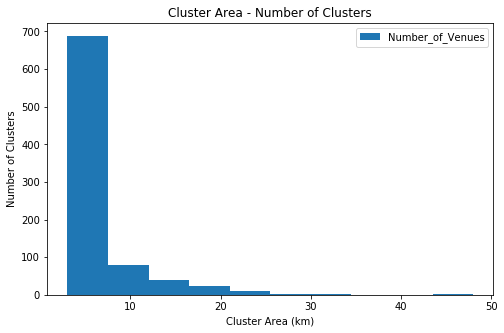

In [135]:
print ('Largest Cluster: \t', venues.Cluster_area.max(), ' km')
print ('Smallest Cluster: \t', venues.Cluster_area.min(), ' km')

df = venues.Cluster_area.value_counts().sort_index(ascending=False).to_frame()
df.reset_index(inplace=True)
df.columns=['Area_Size','Number_of_Venues']
df.set_index(['Area_Size'], inplace=True)
#print (df.head(10))

def plot_hist(v_top):
    v_top.plot(kind='hist', figsize=(8, 5))
    
    plt.title('Cluster Area - Number of Clusters') 
    plt.ylabel('Number of Clusters') 
    plt.xlabel('Cluster Area (km)') # add x-label
    plt.show()

# Distribution from Venues per Group:
plot_hist(df)

#print ('\n Largest Areas')
#print (venues.Cluster_area.value_counts().sort_index(ascending=False).head(10))

#print ('\n Smalest Areas')
#venues.Cluster_area.value_counts().sort_index(ascending=True).head(10)

In [122]:
# Draw Map with Venues colored by Cluster:
#loc_lat, loc_lng = venues.loc[venues['city']== l , ['n_lat', 'n_lng']][0:1].values[0]
L = 2
location = [['Rio de Janeiro',-22.9110137,-43.2093727, 11],['São Paulo',-23.6236475,-46.3776385915519,11], ['RJ_SP', -23.234970, -44.708555,8]]
[l, loc_lat, loc_lng,zoom] = location[L]

#print (loc_lat, loc_lng, l)

venues['v_color'] = 'lightblue'
for i in venues['Cluster'].value_counts().index:
    venues.loc[venues.Cluster == i, ['v_color']]= colors_list[i]
print ('venue')
venues['_venue'] = venues['Cluster'].astype(str) + venues['venue']

z = 8
draw_map(venues,l,z, loc_lat, loc_lng)

venue
4938


### Categories Score

Create a score 5 to 1, for each Categorie. 
The Categorie in same business area have big score 5, and with less interess score 1.  
This score will considere.

In [123]:
#print (venues.v_cat.value_counts())
cat_score = pd.DataFrame(
    [['Coffee Shop',5],['Tea Room',5],['Snack Place',4],['Chocolate Shop', 4],['Sandwich Place',3],['Bakery',2],['Breakfast Spot',4]],
    columns=['v_cat','cat_score'])
cat_score

,v_cat,cat_score
0,Coffee Shop,5
1,Tea Room,5
2,Snack Place,4
3,Chocolate Shop,4
4,Sandwich Place,3
5,Bakery,2
6,Breakfast Spot,4


In [124]:
venues = venues.merge(cat_score, on='v_cat')

### Score

Venue Score:

    * 45% cat_score - Score according Venue Categorie. High value, high score. 
    * 10% top_n - Venue is part of a Group
    * 10% v_total - Number of Venues in that Group. 
    * 25% v_price - Price acquiring from Venue Detail from FourSquare. More expensive high score.

Cluster Score:

    * 70% Sum Venue Score
    * 30% Cluster Area - Small cluster have a high score.

In [125]:
# Change Cluster Area to Pencentage, and invert value to score to small cluster get a high score. 
print ('Sample:\n', venues.Cluster_area.head(10))
print ('Min: ', venues.Cluster_area.min())
print ('Max: ', venues.Cluster_area.max())

venues['Cluster_area_score'] = ( 1 - (venues.Cluster_area / venues.Cluster_area.max()))*100
print ('Score Sample:\n', venues.Cluster_area_score.head(10))
print ('Min: ', venues.Cluster_area_score.min())
print ('Max: ', venues.Cluster_area_score.max())

Sample:
 0     5.139410
1     0.988367
2     1.334899
3     0.319589
4     0.285118
5    16.098764
6     0.437024
7     0.884136
8     0.185583
9     2.870599
Name: Cluster_area, dtype: float64
Min:  0.000700992247315
Max:  79.6092391146
Score Sample:
 0    93.544203
1    98.758477
2    98.323186
3    99.598553
4    99.641853
5    79.777770
6    99.451039
7    98.889405
8    99.766883
9    96.394139
Name: Cluster_area_score, dtype: float64
Min:  0.0
Max:  99.9991194587


In [126]:
# venues.columns

In [127]:
#venues['score'] = 0.45 * venues['cat_score'] + 0.1 * venues['top_n'] + 0.1 * venues['v_total'] + 0.25 * venues['v_price']
venues['score'] = 0.45 * venues['cat_score'] + 0.2 * venues['top_n'] * venues['v_total'] + 0.25 * venues['v_price']

print ('Max score: ', venues['score'].max())
print ('Min score: ', venues['score'].min())

venues['score'].value_counts().head(10)

print ('Result: ', venues.size)

Max score:  35.8
Min score:  0.9
Result:  113574


In [137]:
#print ('Result: ', venues.shape)
cluster = venues[['Cluster', 'Cluster_area', 'city', 'Cluster_lat', 'Cluster_lng']]
cluster = cluster.loc[cluster.duplicated('Cluster',keep='first')==False]

x = venues.groupby('Cluster')['score'].agg('mean').to_frame()
cluster = cluster.merge( x, left_on='Cluster', right_index=True)
#x = venues.groupby('Cluster')['score'].agg('count').to_frame()
#cluster = cluster.merge( x, left_on='Cluster', right_index=True)

col = ['v_lat', 'v_lng', 'venue', 'v_color','Cluster', 'Cluster_lat', 'Cluster_lng']
venues_result = pd.DataFrame(columns=col)

for c in ['São Paulo', 'Rio de Janeiro']:
    x = cluster.loc[cluster['city'] == c].sort_values('score',ascending=False).iloc[:20]
    venues_result =  venues_result.append( venues.loc[ venues.Cluster.isin(x.Cluster.tolist()), col] , ignore_index=True)
    #print (x)

#print (cluster.loc[cluster['city'] == 'Rio de Janeiro'].sort_values('score_x',ascending=False).head(20))
#print ('Result: ', venues_result.shape)
#print ('Result: ', venues.shape)

In [174]:
#Debug:
# venues['score'] = 0.45 * venues['cat_score'] + 0.1 * venues['top_n'] + 0.1 * venues['v_total'] + 0.25 * venues['v_price']
# venues_result.loc[venues_result.Cluster == 613]

In [267]:
# print (venues_result.shape)
# venues_result.head()

for c in ['Rio de Janeiro', 'São Paulo']:
    j = venues.loc[venues.Cluster.isin(venues_result['Cluster']) & venues.city.isin([c]),['Cluster','venue']]
    pd.set_option('max_colwidth', 150)
    print ('Top 20 Cluster from ', c)
    display (j.groupby("Cluster")['venue'].apply(lambda venue: ', '.join(venue)).to_frame())


Top 20 Cluster from  Rio de Janeiro


,venue
Cluster,
542,"Cacau Show, Kopenhagen, Rei do Mate, MegaMatte"
551,"775 Gourmet, Mano's Café, California Coffee, McCafé, Kopenhagen, Chocolates Brasil Cacau, Cacau Show, Rei do Mate, MegaMatte"
561,"Brownieria, McCafé, Mr. Cheney Cookies, Viena Café, Pão & Companhia, California Coffee, Starbucks, Bacio di Latte, Expresso Pão de Queijo, Kopenha..."
570,"Village Griffe do Pão, Brownieria, Casa do Pão de Queijo, California Coffee, Kopenhagen, Cacau Show, Pastelaria Caiana, Subway, MegaMatte, Rei do ..."
582,"California Coffee, La Dolce Vita, Cacau Show, Subway, MegaMatte"
588,"Cantina do Senai, Cacau Show, Subway"
589,"Grão Expresso, Starbucks, Starbucks, Katz Chocolates, Kopenhagen"
601,"Trigô Panetteria, Cacau Show, Rei do Mate"
606,"Cacau Show, Chocolates Brasil Cacau, Subway"


Top 20 Cluster from  São Paulo


,venue
Cluster,
34,"Starbucks, Estação 5 Café, Coffeetown, Casa do Pão de Queijo, Cacau Show, Cacau Show, Chocolates Brasil Cacau, Kopenhagen, Rei do Mate"
90,"Casa do Pão de Queijo, Cacau Show, Rei do Mate"
92,"Inverno D'Italia, Starbucks, Cacau Show, Munik Chocolates, Kopenhagen"
118,"Coffee Tree, Cacau Show, Subway"
127,"Santa Ignacia Bake House, Starbucks, Subway"
139,"Cacau Show, Kopenhagen, Rei do Mate"
145,"Café do Ponto, Casa Bauducco, Cacau Show, Kopenhagen, Rei do Mate"
173,"Kopenhagen, Cacau Show, Frutaria Continental"
175,"Havanna Café, Starbucks, Kopenhagen, Lindt"


In [131]:
from folium.features import DivIcon

# Function Draw Map
from folium.features import *
def draw_map_v2(df,l,z, loc_lat, loc_lng, dfCluster):
    venues_map = folium.Map(location=[loc_lat, loc_lng], zoom_start=z)
    # Bug with special character "'" in Label.
    df['_venue'] = df.loc[:,'_venue'].str.replace('\'', '')

    for lat, lng, label, color in zip(df.v_lat, df.v_lng, df._venue, df.v_color):
        #folium.features.CircleMarker(
        folium.CircleMarker(
            [lat, lng],
            radius=5,
            popup=label,
            fill=True,
            color=color,
            fill_color=color,
            fill_opacity=0.6
        ).add_to(venues_map)
    
    for lat, lng, label in zip(dfCluster.Cluster_lat , dfCluster.Cluster_lng, dfCluster.Cluster):
        folium.Marker([lat,lng], icon=DivIcon(
            icon_size=(75,36),
            icon_anchor=(7,20),
            html=('<div style="font-size: 11pt; color : black">{}</div>').format(label),
        )).add_to(venues_map)
        venues_map.add_child(folium.CircleMarker([lat,lng], radius=15))
    
    print (df.venue.count())
    return(venues_map)

# List of Colors to use with marks
colors_list = list(colors._colors_full_map.values())
colors_list = list(filter(lambda x: x[0] == '#', colors_list))
print (len(colors_list))

1155


In [141]:
dfCluster = venues_result[['Cluster', 'Cluster_lat', 'Cluster_lng']]
dfCluster = dfCluster.loc[dfCluster['Cluster'].duplicated(keep='first') == False]
# print (dfCluster.shape)
#dfCluster.head()

In [133]:
#loc_lat, loc_lng = venues.loc[venues['city']== l , ['n_lat', 'n_lng']][0:1].values[0]
L = 2
location = [['Rio de Janeiro',-22.9110137,-43.2093727, 11],['São Paulo',-23.6236475,-46.3776385915519,11], ['RJ_SP', -23.234970, -44.708555,8]]
[l, loc_lat, loc_lng,zoom] = location[L]

#print (loc_lat, loc_lng, l)

if (True):
    venues_result['v_color'] = 'lightblue'
    for i in venues_result['Cluster'].value_counts().index:
        venues_result.loc[venues_result.Cluster == i, ['v_color']]= colors_list[i]
    venues_result['_venue'] = venues_result['Cluster'].astype(str) + venues_result['venue']

    
z = 8
#draw_map(venues_result,l,z, loc_lat, loc_lng)
draw_map_v2(venues_result,l,z, loc_lat, loc_lng, dfCluster)

202


## MAP

### Map of Rio de Janeiro - Venues -

In [134]:
# 15 color to mark 15 group with high number of shops:
colors = [
    'red',
    'darkred',
    'lightred',
    'orange',
    'beige',
    'blue',
    'darkblue',
    'lightblue',
    'purple',
    'darkpurple',
    'pink',
    'green',
    'darkgreen',
    'lightgreen',
    'cadetblue',
    'lightgray',
]

# Insert column in Dataframe to Color. Default color: gray:
venues['v_color'] = 'gray'

# Color by Top Venue / City:
if False:
    for k in venues['city'].value_counts().items(): 
        tp_df = venues[venues.city.isin([k[0]])].groupby(['venue']).count()[['neighborhood']].sort_values('neighborhood', ascending=False)[0:N]
        #print (tp_df.index)
        for v, c in zip (tp_df.index, colors):
            #print (c, '--', v)
            #print (venues.loc[venues[venues.city.isin([k[0]])].index.values,['v_color']])
            venues.loc[venues[venues.city.isin([k[0]]) & venues.venue.isin([v])].index.values,['v_color']] = c

# Color top N Venue :
if True:
        tp_df = venues.groupby(['venue']).count()[['neighborhood']].sort_values('neighborhood', ascending=False)[0:N]
        #print (tp_df.index)
        for v, c in zip (tp_df.index, colors):
            #print (c, '--', v)
            #print (venues.loc[venues[venues.city.isin([k[0]])].index.values,['v_color']])
            venues.loc[venues[venues.venue.isin([v])].index.values,['v_color']] = c
        
#venues.loc[venues[venues.city.isin(['São Paulo']) & venues.venue.isin(['Starbucks'])].index.values,['v_color']] = 'red'
# print (venues[['city','venue','v_color']].head(10))         

In [143]:
#loc_lat, loc_lng = venues.loc[venues['city']== l , ['n_lat', 'n_lng']][0:1].values[0]
L = 2
location = [['Rio de Janeiro',-22.9110137,-43.2093727, 11],['São Paulo',-23.6236475,-46.3776385915519,11], ['RJ_SP', -23.234970, -44.708555,8]]
[l, loc_lat, loc_lng,zoom] = location[L]

#print (loc_lat, loc_lng, l)

venues['v_color'] = 'lightblue'
for i in venues['Cluster'].value_counts().index:
    venues.loc[venues.Cluster == i, ['v_color']]= colors_list[i]
venues['_venue'] = venues['Cluster'].astype(str) + venues['venue']

z = 8
draw_map(venues,l,z, loc_lat, loc_lng)

4934


In [144]:
#venues_map.add_child(plugins.HeatMap(zip(venues.v_lat, venues.v_lng, venues.Total), radius = 10))
#venues_map

venues_map = folium.Map(location=[loc_lat, loc_lng], zoom_start=8)
venues_latlng = [[v[0], v[1], v[2]] for v in venues[['v_lat','v_lng','v_total']].values.tolist()]
HeatMap(venues_latlng, show=True,overlay=True, control=True).add_to(venues_map)
venues_map

In [158]:
#venues_map.add_child(plugins.HeatMap(zip(venues.v_lat, venues.v_lng, venues.Total), radius = 10))
#venues_map

venues_map = folium.Map(location=[loc_lat, loc_lng], zoom_start=8)
#venues_latlng = [[v[0], v[1], v[2]] for v in venues_result[['v_lat','v_lng','v_total']].values.tolist()]
venues_latlng = [[v[0], v[1], v[2]] for v in venues[['v_lat','v_lng','score']].values.tolist()]
HeatMap(venues_latlng, show=True,overlay=True, control=True).add_to(venues_map)
venues_map